<a href="https://colab.research.google.com/github/jeffmcm1977/CMBAnalysis_SummerSchool/blob/master/CMB_School_Part_09.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mapmaking

### Code from Sigurd Naess, addapted by Jeff McMahon


CMB telescopes observe by scanning accross the sky and recording the response of each detector as a funciton of time as well as pointing information.  The detector response time series is commonly refered to as time ordered data or a TOD.  Each CMB field is usually observed many times over the course of one or more seasons yielding a large nunber of overlapping TODs.   At the pole the sky rotation is alligmed with the elevation axis of a telescope resulting in paralell scans in sky coordinates.  At midlattitude sites there is no such alignment and sky rotation can produce cross-linked scans.  Offline the TODs are processed to reconstruct the maps.   

In this notebook you will (1) model TODs for a map that is obsered horizontally and vertically to create a cross-linked set of TODs, (2) add 1/f noise to create TODs similar to what would be output from a CMB instrument, and (3) you will use several mapmaking codes to reconstruct maps from these time streams.   The mapmaking codes include (i) a simple binned average that works well if the TODs have negliagble white noise (from the instrument (e.g., ddemodulated half-wave plate polarziation data) or by prewhitening the data with a filter), and (ii) an iterative maximum liklihood mapmaker that accounts for the noise correlations from the atmosphere.

Excercises will guide you through the differences between cross-linked and non-crosslinked maps, and the impacts of filtering before and after mapmaking.

## First we read in the necessary libraries from previous code modules.

In [1]:
!python -c "import cmb_modules" || ( \
    wget cmb_school.tar.gz && \
    tar xzvf cmb_school.tar.gz \
)

In [161]:
import numpy as np
import matplotlib
import matplotlib.cm as cm
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
import astropy.io.fits as fits
import healpy as hp
import scipy as sp

import constants as cs # the constants module
import cmb_modules # the module of functions

N = int(cs.N)
c_min = cs.c_min
c_max = cs.c_max
X_width =cs.X_width
Y_width = cs.Y_width
beam_size_fwhp = cs.beam_size_fwhp

pix_size = cs.pix_size
print("pixel size: ", pix_size)

Number_of_Sources  = cs.Number_of_Sources
Amplitude_of_Sources = cs.Amplitude_of_Sources
Number_of_Sources_EX = cs.Number_of_Sources_EX
Amplitude_of_Sources_EX = cs.Amplitude_of_Sources_EX

Number_of_SZ_Clusters  = cs.Number_of_SZ_Clusters
Mean_Amplitude_of_SZ_Clusters = cs.Mean_Amplitude_of_SZ_Clusters
SZ_beta = cs.SZ_beta
SZ_Theta_core = cs.SZ_Theta_core

pixel size:  0.5


## Recalculating the results from the previous stages

This creates a map with CMB, point sources, and SZ sources.  It also convolces the map with the beam.  Unlike previous maped based simulations, noise will be added in the time series which are calculated below.

/home/matias/Documentos/PhD/CMBAnalysis_SummerSchool/cmb_modules.py:15: RuntimeWarning: invalid value encountered in divide
  ClTT = DlTT * 2 * np.pi / (ell * (ell + 1.0))


Number of sources required:  5000
map mean: -66.22633665962397 map rms: 95.94653634690758


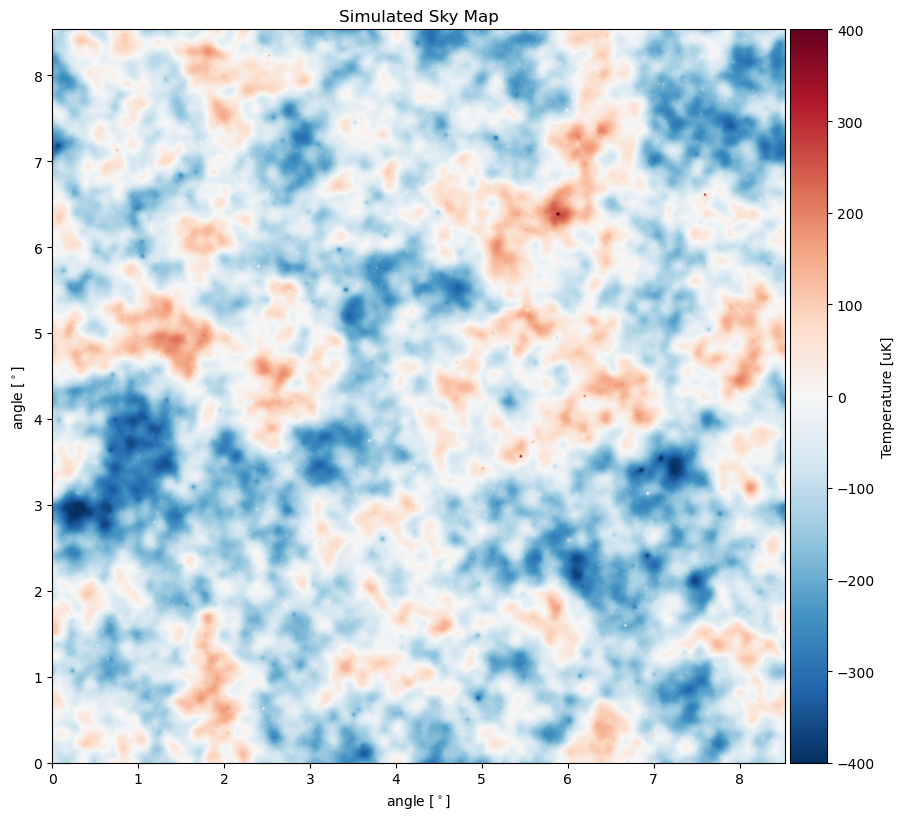

In [256]:
## Make a CMB map
ell, DlTT = np.loadtxt("CAMB_fiducial_cosmo_scalCls.dat", usecols=(0, 1), unpack=True) 
CMB_T = cmb_modules.make_CMB_T_map(N,pix_size,ell,DlTT)

## make a point source map
PSMap = cmb_modules.Poisson_source_component(N,pix_size,Number_of_Sources,Amplitude_of_Sources) 
PSMap += cmb_modules.Exponential_source_component(N,pix_size,Number_of_Sources_EX,Amplitude_of_Sources_EX)

## make an SZ map
SZMap,SZCat = cmb_modules.SZ_source_component(N,pix_size,Number_of_SZ_Clusters,\
                                  Mean_Amplitude_of_SZ_Clusters,SZ_beta,SZ_Theta_core,False)

## add them all together to get the sky map at a single freuqency
total_map = CMB_T + PSMap + SZMap


## convolve with the beam
CMB_T_convolved = cmb_modules.convolve_map_with_gaussian_beam(N,pix_size,beam_size_fwhp,total_map)

## plot the result
plt.title("Simulated Sky Map")
p=cmb_modules.Plot_CMB_Map(CMB_T_convolved,c_min,c_max,X_width,Y_width)




## save the result as "sky", a variable that represents the simulated sky we will map below
sky = total_map

## Generating time streams from a simulated sky map

This is the first new piece of the notebook.  In this section we simulate the telescope scanning accross the map.  For simplicity we consider two scan directions: left-right, and up-down. This code generates a list of pixels (x- and y coordinates) in the order in which they are observed.  



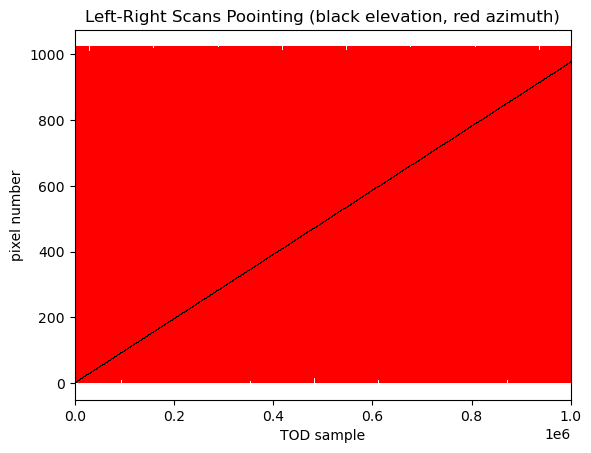

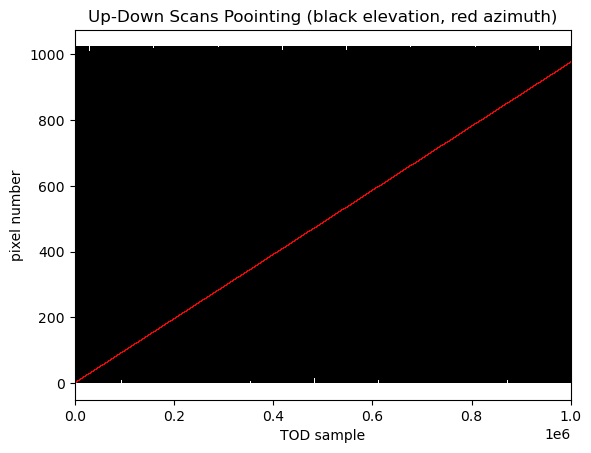

In [257]:

## a function to return the sequence of pixel indices as they are "observed" in these simualtions
def sim_pointing(map, dir=0):
    """Simulate a telescope scanning across the given map. The scanning pattern is
    as simple as possible: The samples hit the center of each pixel, and we
    scan rowwise (dir=0) or columnwise (dir=1)."""
    # The pointing is an [{y,x},nsamp] array of pixel positions
    # The einsum stuff is just to swap the second and third axis
    # of pixmap, which contains the pixel coordinates of each pixel.
    pixmap = np.mgrid[:map.shape[-2],:map.shape[-1]]  ## makes two arrays of the x and y indices in the map
    pixmap[1,1::2, :] = pixmap[1,1::2, ::-1]          ## reverse ever other row so the scans go back and forth
    # 1::2 es seleccionar las filas impares, -1  es invertir
    if dir == 0: point = pixmap.reshape(2,-1)         ## arranges these for L-R scans
    # con el reshape(2,-1) se aplana el array dejando las dos primeras dimensiones (y,x) y lo demás son los pixeles recorridos en el orden de escaneo
    else:        point = np.roll(pixmap,1,axis=0).reshape(2,-1)   ## arranges these for U-D scans
    # con el np.roll se intercambian las dos primeras dimensiones (x,y) para que el escaneo sea U-D
    return point


# pixmap es un array de 2 x 1024 x 1024 donde pixmap[0,:,:] son las coordenadas en y (elevacion) y pixmap[1,:,:] son las coordenadas en x (azimut)
# 

## generate left-right scans
point_lr = sim_pointing(sky, 0)

## generate Up-Down scans
point_ud = sim_pointing(sky, 1)


# point[0,:] son las coordenadas en y (elevacion)
# point[1,:] son las coordenadas en x (azimut)

plt.plot(point_lr[1,:],"r,")
plt.plot(point_lr[0,:],"k,")
plt.title("Left-Right Scans Poointing (black elevation, red azimuth)")
plt.ylabel("pixel number")
plt.xlabel("TOD sample")
plt.xlim(0,1e6)
plt.show()

plt.plot(point_ud[0,:],"k,")
plt.plot(point_ud[1,:],"r,")
plt.title("Up-Down Scans Poointing (black elevation, red azimuth)")
plt.ylabel("pixel number")
plt.xlabel("TOD sample")
plt.xlim(0,1e6)
plt.show()

In [22]:
np.shape(point_lr)

(2, 1048576)

<font color='red'>EXERCISE: </font>  Make a zoomed in plot of the scan strategies above by adjusting the x limit for the plot to be much smaller.     Discribe the scan strategy based on what you see in these plots.

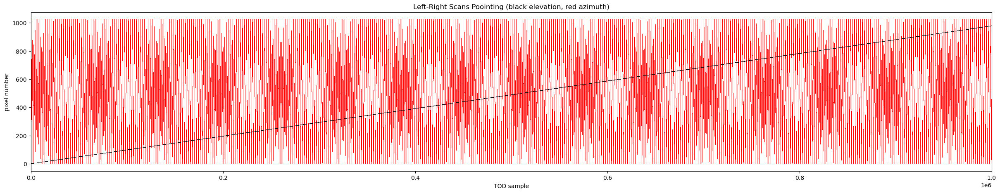

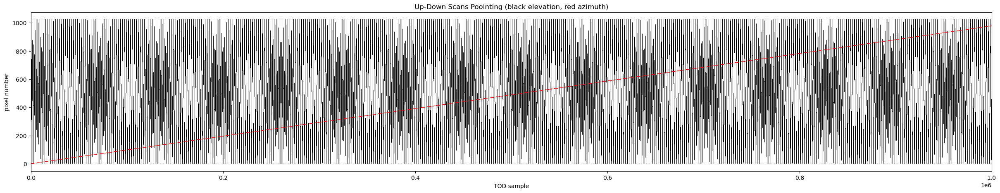

In [258]:
# make your plots here

plt.figure(figsize=(30,5))
plt.plot(point_lr[1,:],"r,")
plt.plot(point_lr[0,:],"k,")
plt.title("Left-Right Scans Poointing (black elevation, red azimuth)")
plt.ylabel("pixel number")
plt.xlabel("TOD sample")
plt.xlim(0,1e6)
plt.legend
plt.show()

plt.figure(figsize=(30,5))
plt.plot(point_ud[0,:],"k,")
plt.plot(point_ud[1,:],"r,")
plt.title("Up-Down Scans Poointing (black elevation, red azimuth)")
plt.ylabel("pixel number")
plt.xlabel("TOD sample")
plt.xlim(0,1e6)
plt.show()

#### discusson goes here

### noisless TODs

This code takes the pointing information generated above an makes a mock TOD with no noise.

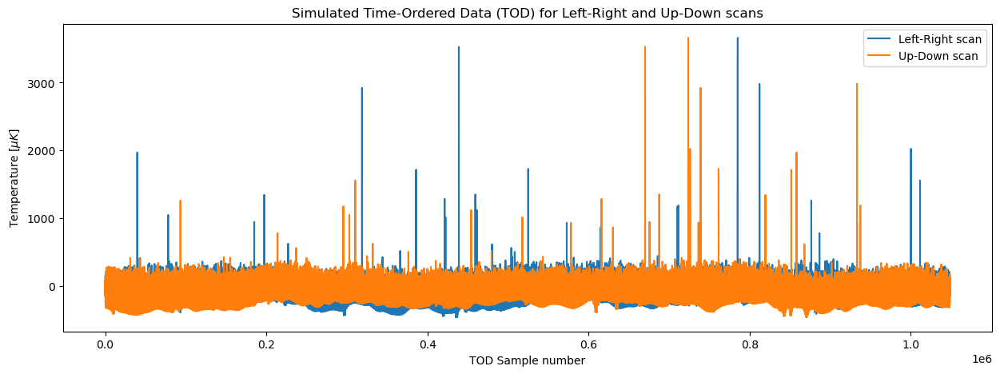

In [259]:
def Observe_map(map, point):
    """Pointing matrix: Project map to tod"""
    point = np.round(point).astype(int)
    return map[point[0],point[1]]  ## return the value of the map at each pointing, this forms the simulated time stream



noisless_tod_lr = Observe_map(sky, point_lr)
noisless_tod_ud = Observe_map(sky, point_ud)


plt.figure(figsize=(15,5))
plt.title("Simulated Time-Ordered Data (TOD) for Left-Right and Up-Down scans")
plt.xlabel("TOD Sample number")
plt.ylabel(r"Temperature [$\mu K$]")
plt.plot(noisless_tod_lr)
plt.plot(noisless_tod_ud)
plt.legend(['Left-Right scan','Up-Down scan'])
plt.show()


<font color='red'>EXERCISE: </font>  Explain the spikes in the TOD and discuss weather the RMS of the TOD makes sense.

Los peaks que se ven del TOD corresponden a fuentes brillantes dentro del mapa (recordar que el mapa contiene SZ y fuentes brillantes, como estrellas en formación). El RMS, se puede calcular como:

In [260]:
print('El RMS para el escaneo lr:', np.sqrt(np.mean(noisless_tod_lr**2)))
print('El RMS para el escaneo ud:', np.sqrt(np.mean(noisless_tod_ud**2)))

El RMS para el escaneo lr: 117.88072808942579
El RMS para el escaneo ud: 117.88072808942579


Lo que hace sentido, pues la fluctuación media para los mapas de temperatura del CMB es de $100 \mu K$.

#### discussion goes here

<font color='red'>OPTIONAL EXERCISE: </font> Add in the impact of detector time constants to smear out these TODs.  This excercise is best done aftern completig the rest of the notebook so its impact can be propigatd through this entire code to maps.  This will allow you to model the impact of this sytematic on effect.

NOTE: [this wikipedia article](https://en.wikipedia.org/wiki/Exponential_smoothing) is useful in modeling exponetial filters (e.g., detector time cosntants) This apporach can be implemented with arrays using the np.roll funciton.

### Adding noise to the TOD

Here we build a noise power spectrum for the atmospheric and instrumental noise.   By default we assume the instrumental noise has an amplitude of 40 $\mu$-K per sample (1/2 arcmin pixels) which is similar to the full exposure of ACT-MBAC or SPT-SZ which were around 20 $\mu$ K- arcmin (SPT was slightly lower).   The atmospehric signal is modeled as a simple power law with a 0.1 s 1/f knee and a scan that speends $1/240$ s in each pixel which is equivelent to a $1^ \circ /s$ scan speed.   


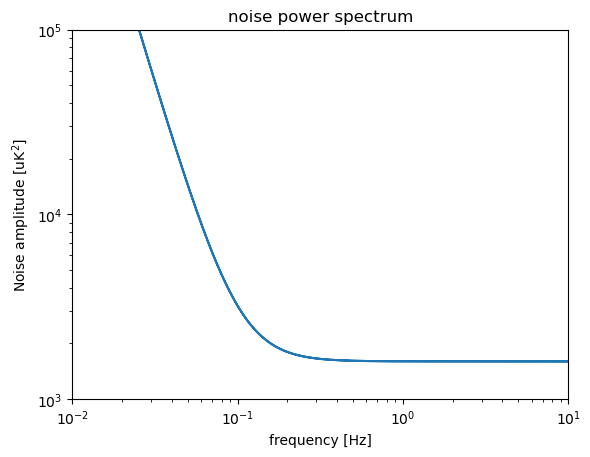

In [261]:
def sim_noise_spec(nsamp, dt=.00416, fknee=0.1, alpha=3, sigma=40):
    """Build a simple atmosphere + white noise model, and return it
    as a power spectrum."""
    freq   = np.abs(np.fft.fftfreq(nsamp, dt))
    return (1+(np.maximum(freq,freq[1])/fknee)**-alpha)*sigma**2



noise_spec_lr = sim_noise_spec(point_lr.shape[-1], dt=.00416, fknee=0.1, alpha=3, sigma=40)
noise_spec_ud = sim_noise_spec(point_ud.shape[-1], dt=.00416, fknee=0.1, alpha=3, sigma=40)
freq   = np.abs(np.fft.fftfreq(point_lr.shape[-1], .00416))

plt.loglog(freq,noise_spec_lr)
plt.title("noise power spectrum")
plt.xlabel("frequency [Hz]")
plt.ylabel("Noise amplitude [uK$^{2}$]")
plt.ylim(1e3,1e5)
plt.xlim(1e-2,10)
plt.show()


The next step is to generate a realization of this noise and add it to the noisless time series.

<>:17: SyntaxWarning: invalid escape sequence '\m'
<>:17: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_7175/3627308031.py:17: SyntaxWarning: invalid escape sequence '\m'
  plt.ylabel("response [$\mu$K]")


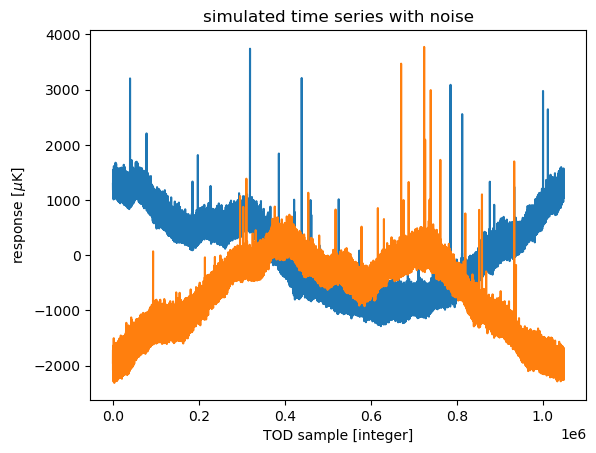

In [262]:
def sim_tod(map, point, noise_spec):
    """Simulate a noisy TOD using the model d = Pm + n"""
    tod    = Observe_map(map, point)
    rand   = np.fft.fft(np.random.standard_normal(tod.shape[-1]))
    fnoise = rand * noise_spec**0.5
    tod   += np.fft.ifft(fnoise).real
    return tod



tod_lr = sim_tod(sky, point_lr, noise_spec_lr)
tod_ud = sim_tod(sky, point_ud, noise_spec_ud)

plt.plot(tod_lr)
plt.plot(tod_ud)
plt.title("simulated time series with noise")
plt.ylabel("response [$\mu$K]")
plt.xlabel("TOD sample [integer]")
plt.show()

<font color='red'>EXERCISE: </font>  Typical detectors have noises of $ \sim 300 \mu K \sqrt{s}$.  Make a plot of what a time stream looks like with this instantaneous sensitivity so you can get a feel for what real data looks like.

<>:10: SyntaxWarning: invalid escape sequence '\m'
<>:10: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_7175/3072281529.py:10: SyntaxWarning: invalid escape sequence '\m'
  plt.ylabel("response [$\mu$K]")


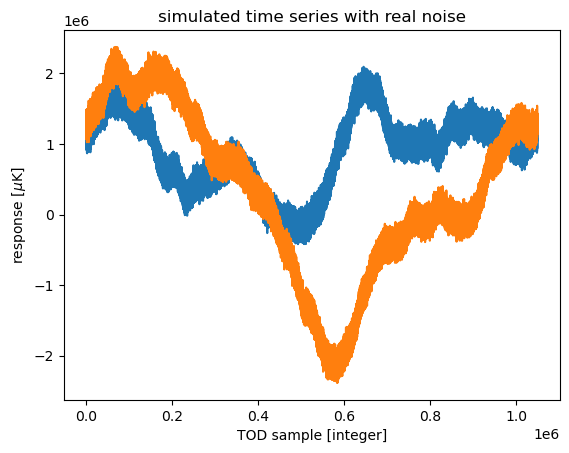

In [263]:

noise_spec_lr_real = sim_noise_spec(point_lr.shape[-1], dt=.00416, fknee=0.1, alpha=3, sigma=300/0.00416)
noise_spec_ud_real = sim_noise_spec(point_ud.shape[-1], dt=.00416, fknee=0.1, alpha=3, sigma=300/0.00416)

tod_lr_real = sim_tod(sky, point_lr, noise_spec_lr_real)
tod_ud_real = sim_tod(sky, point_ud, noise_spec_ud_real)

plt.plot(tod_lr_real)
plt.plot(tod_ud_real)
plt.title("simulated time series with real noise")
plt.ylabel("response [$\mu$K]")
plt.xlabel("TOD sample [integer]")
plt.show()

### write down the noise and 1/f knee you choose here

In [ ]:
## make your plots here

### Putting all the pieces together

For convenience, the following code bundles the TOD (signal and noise), with pointing information, and the noise spectrum into a class.   This object will be passed as input to the map making codes we develope below.

<>:29: SyntaxWarning: invalid escape sequence '\m'
<>:29: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_7175/3263690448.py:29: SyntaxWarning: invalid escape sequence '\m'
  plt.ylabel("response [$\mu$K]")


Generating noisy TOD simulations


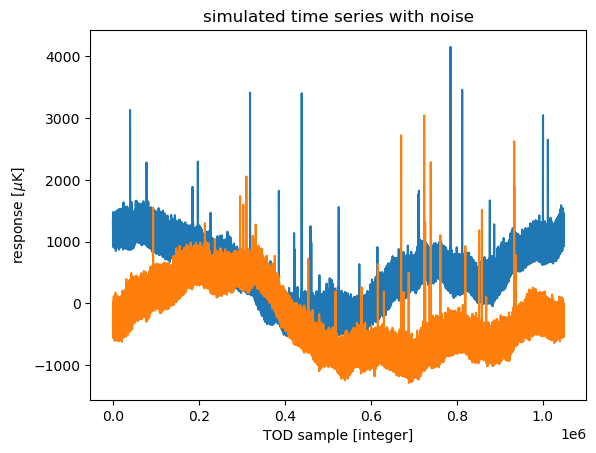

In [264]:
def sim_dataset(map, num_data=2, dt=.00416, fknee=0.1, alpha=3, sigma=40):
    """Simulate a dataset consisting of num_data scans across the sky.
    Returns a list of Data objects, each of which contains the tod,
    the pointing and the noise spectrum."""
    res = []
    for i in range(num_data):
        point = sim_pointing(map, i % 2)
        noise_spec = sim_noise_spec(point.shape[-1], dt=dt, fknee=fknee, alpha=alpha, sigma=sigma)
        tod = sim_tod(map, point, noise_spec)
        res.append(Data(tod, point, noise_spec))
    return res


class Data:
    def __init__(self, tod, point, noise_spec):
        self.tod   = tod
        self.point = point
        self.noise_spec = noise_spec




print("Generating noisy TOD simulations")
dataset  = sim_dataset(sky,num_data=2, dt=.00416, fknee=0.1, alpha=3, sigma=40)
for data in dataset:
    plt.plot(data.tod)
    
plt.title("simulated time series with noise")
plt.ylabel("response [$\mu$K]")
plt.xlabel("TOD sample [integer]")
plt.show()

# naieve mapmaking

Making maps from TODs is an inverse problem.  It can be epxressed in matrices as:
$$ P m = d.$$
Here $d$ is the TOD (which is a vector), $m$ is the sky map (which is also a vector), and $P$ is a (typically) rectangular matrix that specifies which pixel in the map was observed during each TOD sample.  (NOTE: many TOD sampeles usually correspond to the same pixel in our sky map).  

To solve for a map $m$ given our TODs ($d$) we must invert this equation.   The standard technique is to use chi-squared minimization.   Expressed in matrices this apporach can be accomplished as derived here: 
$$ P m = d$$
$$ P^tP m  = P^t d      $$
$$ m = [P^tP]^{-1} P^t d.  $$

In other wordes, we can use the pointing matrix to construct a matrix $[P^tP]^{-1} P^t$ that acts on the TODs to return an estimate for the map.  The difficulty is implementing this when the number of samples in the TODs are large, and in the presence of noise.

We have entirely ignored noise at this point.  (Noise correlations will be dealt with below.  
However, in the limit where the noise is white the above equation can be solved with a simple binned average.  In this case one simply averages the TOD samples which observae a given pixel and returns a map comprized of these averages.  We implement this below and highlight the value and limitations of such code.  (The value is it is fast)

Solving for map while ignoring noise correlations
map mean: 116.22282546205058 map rms: 352.9028429305469


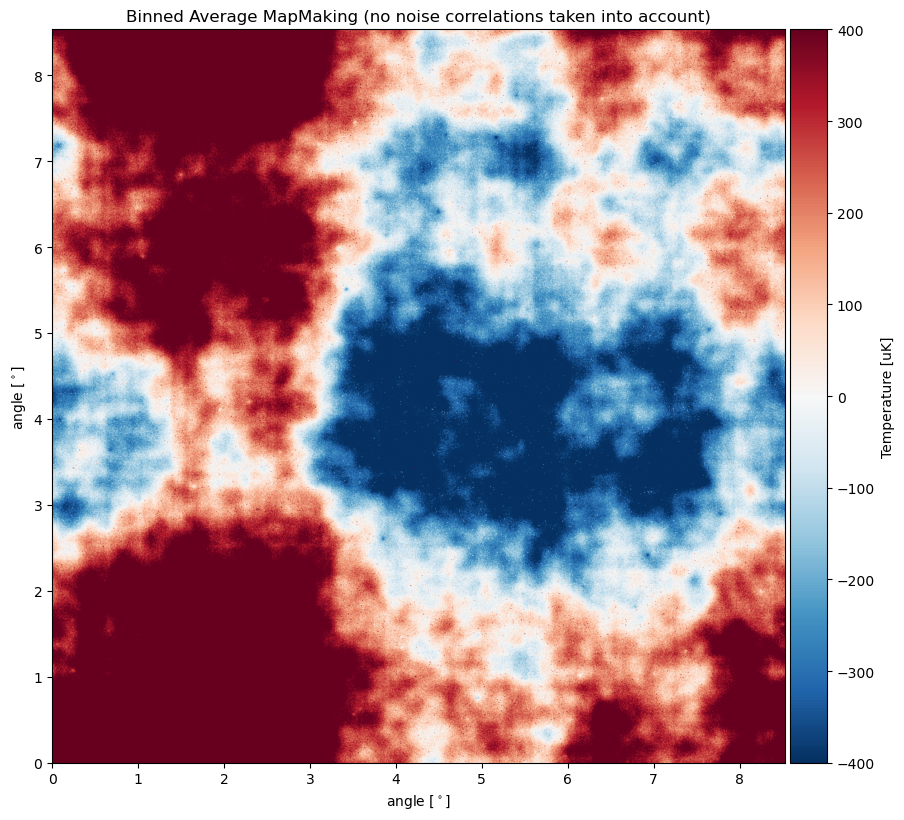

map mean: -66.22633665962394 map rms: 97.51891297353188


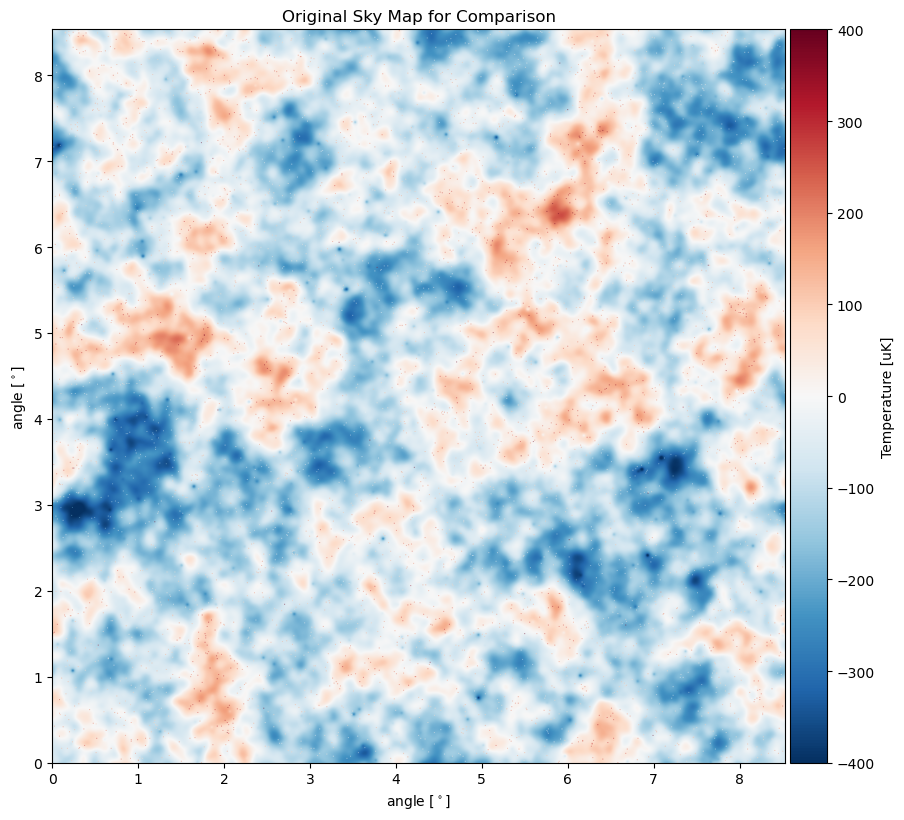

map mean: 182.44916212167453 map rms: 342.87092227866106


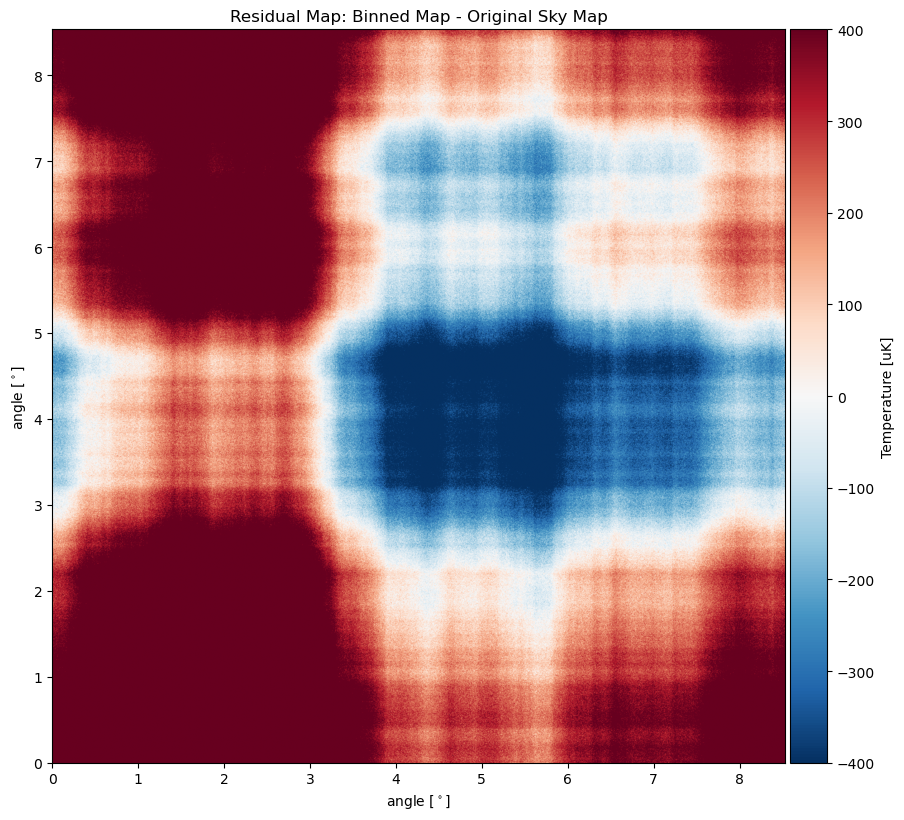

In [266]:
def solve_binned_average(dataset, shape):
    """Solve the simplified mapmaking equation Ax=b,
    where A = P'P and b = P'd, e.g. ignoring noise
    properties such as correlations."""
    # forma clever de hacer (P'P)^-1 P'd, es decir se promedia por bins simples
    rhs  = np.zeros(shape)
    hits = np.zeros(shape)
    for data in dataset:
        rhs  += PT(data.tod,    data.point, shape)
        hits += PT(data.tod*0 + 1, data.point, shape) # 
    return rhs/hits

def PT(tod, point, shape):
    """Transpose pointing matrix."""
    # forma clever de hacer P^t
    point = np.round(point).astype(int)
    point_flat = np.ravel_multi_index(point, shape[-2:]) # aplana el array de indices 2D a 1D por cada coordenada
    map = np.bincount(point_flat, tod, minlength=shape[-2]*shape[-1]) # toma el array de indices 1D y cuenta cuántas veces aparece cada índice, sumando los valores de tod correspondientes
    # es decir, suma todas las temperaturas en el mismo píxel
    map = map.reshape(shape[-2:])
    return map


print("Solving for map while ignoring noise correlations")
map_binned = solve_binned_average(dataset, sky.shape)

plt.title("Binned Average MapMaking (no noise correlations taken into account)")
p=cmb_modules.Plot_CMB_Map(map_binned,c_min,c_max,X_width,Y_width)

plt.title("Original Sky Map for Comparison")
p=cmb_modules.Plot_CMB_Map(sky,c_min,c_max,X_width,Y_width)  #for comparison 

plt.title("Residual Map: Binned Map - Original Sky Map")
p =cmb_modules.Plot_CMB_Map(map_binned - sky,c_min,c_max,X_width,Y_width)

<font color='red'>EXERCISE: </font>  Do you see comon structures in this map and the input sky map?

comment here

<font color='red'>EXERCISE: </font>  Remake the TOD and this map setting the 1/f knee to be absurly small.  Compare the new result to the originaly input map?

map mean: -61.74527446623489 map rms: 141.9565731619682


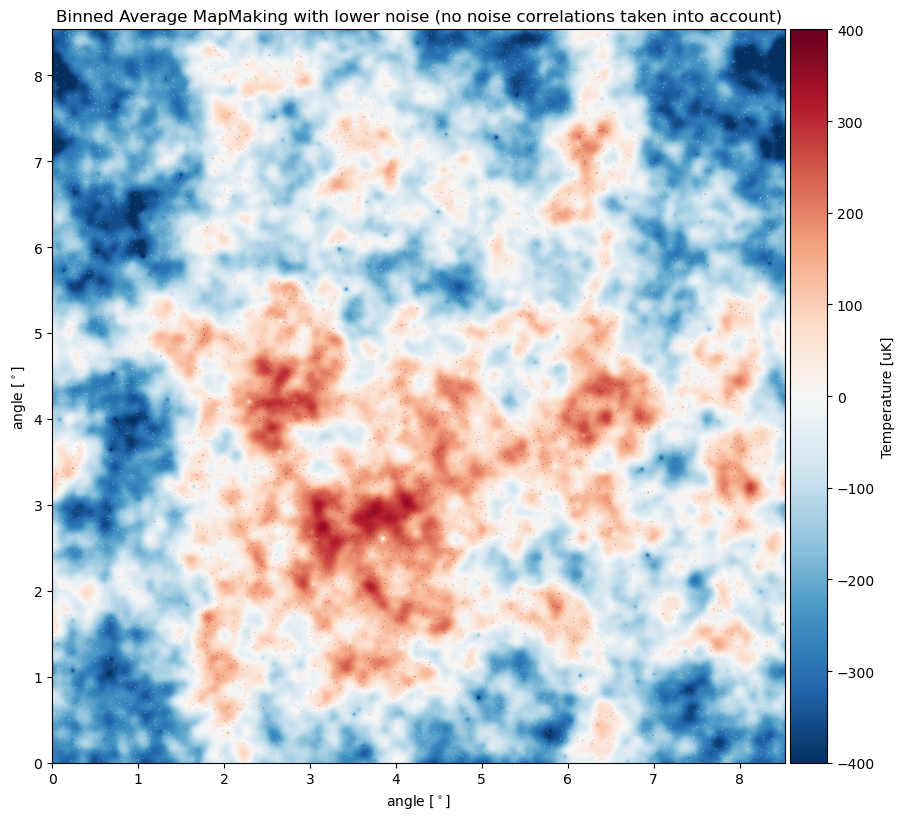

map mean: 4.481062193389057 map rms: 114.59963789336138


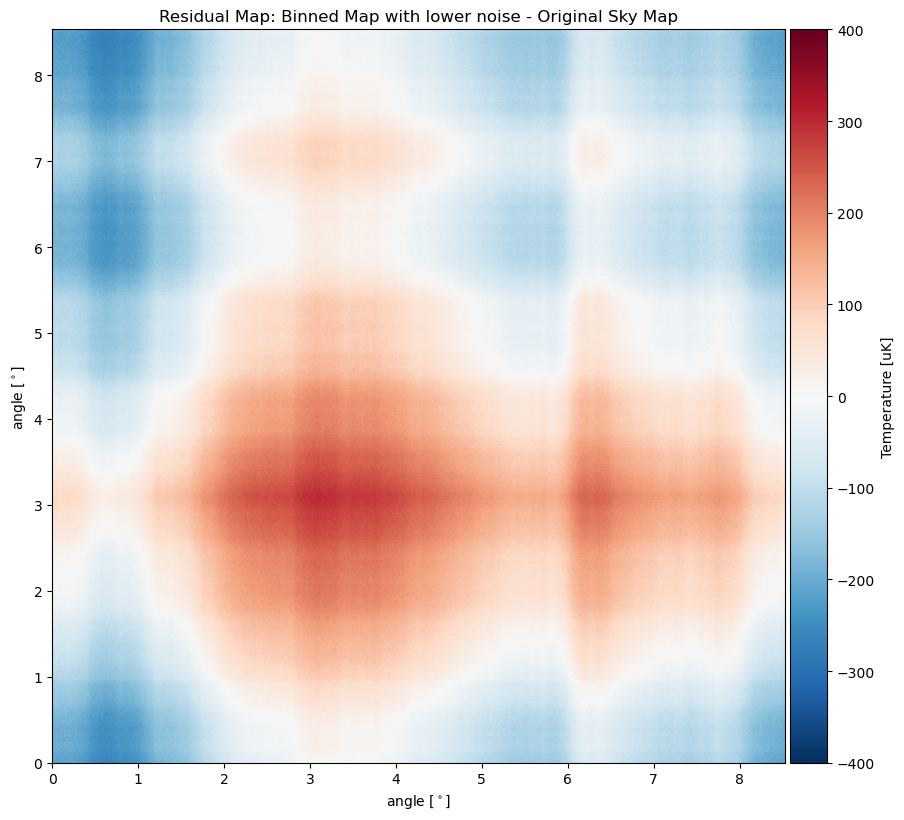

In [267]:
## code goes here

dataset_2 = sim_dataset(sky,num_data=2, dt=.00416, fknee=0.1, alpha=3, sigma=10)

map_binned_2 = solve_binned_average(dataset_2 , sky.shape)

plt.title("Binned Average MapMaking with lower noise (no noise correlations taken into account)")
p=cmb_modules.Plot_CMB_Map(map_binned_2,c_min,c_max,X_width,Y_width)

plt.title("Residual Map: Binned Map with lower noise - Original Sky Map")
p = cmb_modules.Plot_CMB_Map(map_binned_2-sky,c_min,c_max,X_width,Y_width)

# con eso hacemos el ruido 1/f muy bajo

comment here

Notar que si el ruido $1/f$ es lo suficientemente bajo, con el método bineado de mapmaking, se obtiene prácticamente el mismo mapa de entrada.


<font color='red'>EXERCISE: </font>  reset the 1/f knee to its original value.  Now filter the time-series using a high-pass filter with a knee frequency set to whiten the TODs.   Remake the map and compare the new result to the input map.  What is different?

map mean: 0.0 map rms: 93.28549728470917


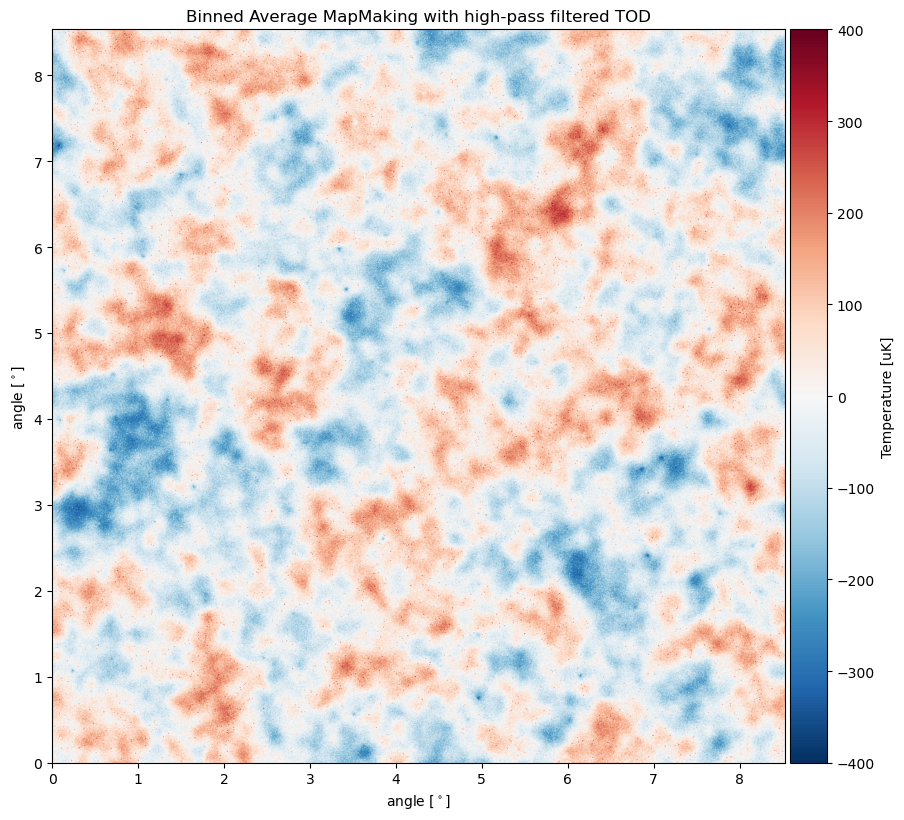

map mean: 66.22633665962395 map rms: 36.5288398097673


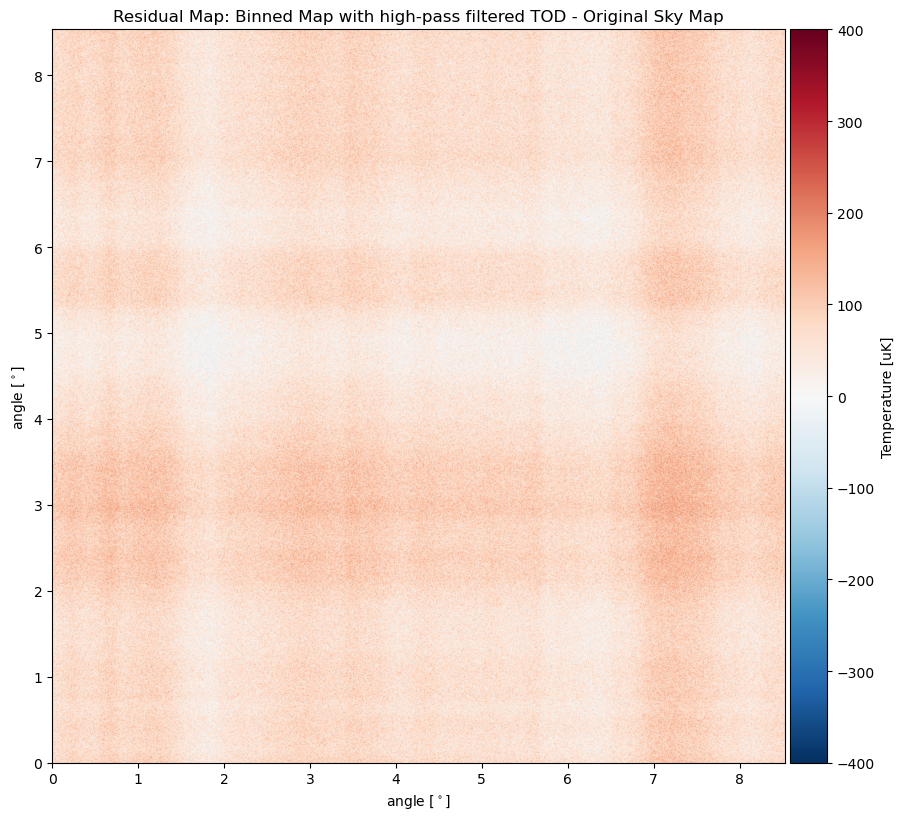

In [268]:
## code goes here

# ahora queremos implementar un filtro de paso alto en e TOD, para ello:

def sim_dataset(map, num_data=2, dt=.00416, fknee=0.1, alpha=3, sigma=40, filter = 0):
    """Simulate a dataset consisting of num_data scans across the sky.
    Returns a list of Data objects, each of which contains the tod,
    the pointing and the noise spectrum."""

        
    res = []

    if filter == 0:
        for i in range(num_data):
            point = sim_pointing(map, i % 2)
            noise_spec = sim_noise_spec(point.shape[-1], dt=dt, fknee=fknee, alpha=alpha, sigma=sigma)
            tod = sim_tod(map, point, noise_spec)
            res.append(Data(tod, point, noise_spec))

    else:
        for i in range(num_data):
            point = sim_pointing(map, i % 2)
            noise_spec = sim_noise_spec(point.shape[-1], dt=dt, fknee=fknee, alpha=alpha, sigma=sigma)
            tod = sim_tod(map, point, noise_spec)
            tod = high_pass_filter_tod(tod, dt, filter)
            res.append(Data(tod, point, noise_spec))
    return res


class Data:
    def __init__(self, tod, point, noise_spec):
        self.tod   = tod
        self.point = point
        self.noise_spec = noise_spec


def high_pass_filter_tod(tod, dt, f_cut):
    """Apply a high-pass filter to the given TOD."""
    freq = np.fft.fftfreq(tod.shape[-1], dt)
    ffilter = np.abs(freq) > f_cut
    ftod = np.fft.fft(tod)
    ftod *= ffilter
    return np.fft.ifft(ftod).real

dataset_3 = sim_dataset(sky,num_data=2, dt=.00416, fknee=0.1, alpha=3, sigma=40, filter= 0.1)

map_binned_3= solve_binned_average(dataset_3 , sky.shape)

plt.title("Binned Average MapMaking with high-pass filtered TOD")
p=cmb_modules.Plot_CMB_Map(map_binned_3,c_min,c_max,X_width,Y_width)

plt.title("Residual Map: Binned Map with high-pass filtered TOD - Original Sky Map")        
p = cmb_modules.Plot_CMB_Map(map_binned_3-sky,c_min,c_max,X_width,Y_width)

comment here

# maximum liklihood mapmaking including noise correlations

Based on what we have seen above we need to develope a map-making apporach that accounts for the noise correlations in our data.   To do this we implement a maximum liklihood mapmaking approiach.  Expressed with matrices this is much like what we did above, except we include weighting by a matrix $N;^{-2}$ whose matdix elements are $1/\sigma^2_{ij}$ and encode the weight of each sample and correlations between samples in the TOD.   WIth this matrix our mapmaking apporach can be derived as follows: 
$$ P m = d$$
$$ N^{-2} P m = N^{-2} d$$
$$ P^tN^{-2}P m  = P^tN^{-2} d      $$
$$ m = [P^tN^{-2}P]^{-1} P^tN^{-2} d.  $$

In summary, the matrix $[P^tN^{-2}P]^{-1} P^tN^{-2}$ can be applied to the TOD $d$ to produce the map $m$.

Given that the matix $N^{-2}$ must have off diagonal terms to encoide noise correlations such as from $1/f$ noise, building this matrix is highly non-trival.  We thus resort to conjugate gradient technique [(see Wikipedia article)](https://en.wikipedia.org/wiki/Conjugate_gradient_method) to invert this equaiton with out ever explicitly building this materix.   These technqiues are iteratative and thus we must run many iterations to arrive at an acceptable estimate for our map. 

We now run this for both a cross-linked and un-cross-linked maps.  Excercises follow.

Solving for map while taking noise correlations into account
iteration:    1 conjugate gradient error:   1.9436229e-02
iteration:    2 conjugate gradient error:   1.0750846e-03
iteration:    3 conjugate gradient error:   2.9568482e-05
iteration:    4 conjugate gradient error:   8.8513087e-06
iteration:    5 conjugate gradient error:   1.0557338e-07
iteration:    6 conjugate gradient error:   5.0734876e-09
iteration:    7 conjugate gradient error:   2.3910049e-10
iteration:    8 conjugate gradient error:   1.1008809e-11
iteration:    9 conjugate gradient error:   9.4569846e-14
iteration:   10 conjugate gradient error:   8.6396846e-15
iteration:   11 conjugate gradient error:   4.0902545e-16
iteration:   12 conjugate gradient error:   6.6484617e-16
iteration:   13 conjugate gradient error:   2.2583087e-14
iteration:   14 conjugate gradient error:   6.7838241e-13
iteration:   15 conjugate gradient error:   2.1328058e-11
iteration:   16 conjugate gradient error:   5.6763316e-10
iteration: 

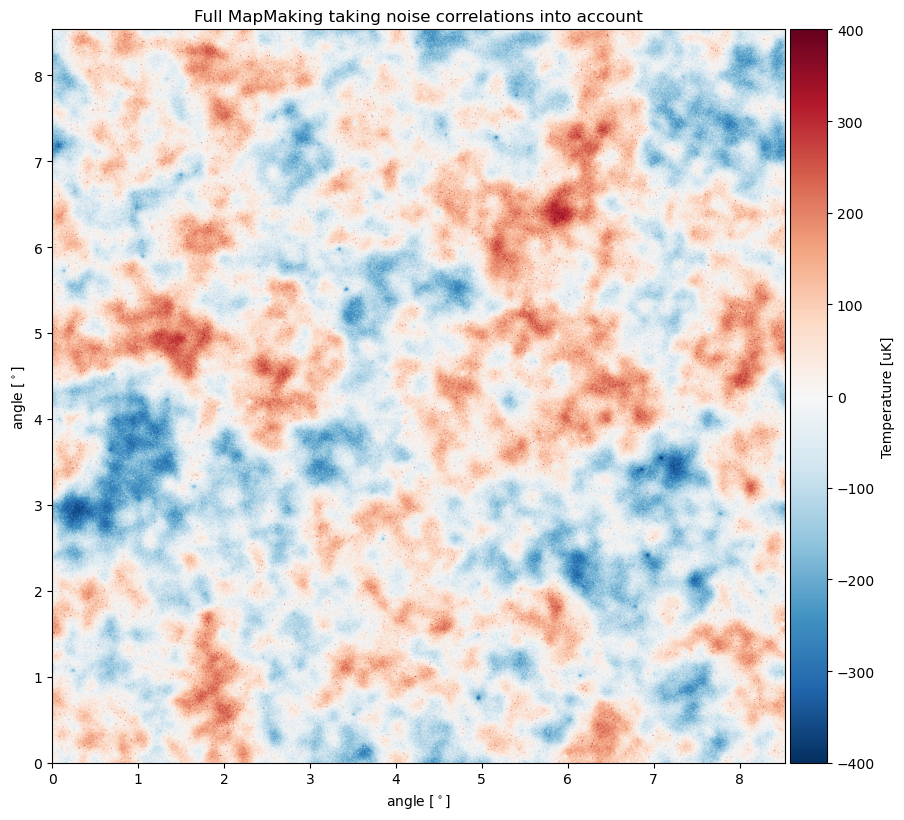

In [269]:
def solve_full(dataset, shape, niter=100, verbose=True):
    """Solve the full map-making equation
    Ax=b, where A = P'N"P and b = P'N"d."""
    # Set up our A matrix. We don't compute
    # explicitly because it's too big. Instead,
    # we define it as a function that can be applied
    # to a vector x. We will then use Conjugate Gradients
    # to invert it.
    def A(x): 
        # x is 1d because the conjugate gradient solver works
        # on 1d arrays. So start by expanding it to 2d.
        x   = x.reshape(shape)
        res = x*0
        for data in dataset:
            # simulamos que vería el telescopio si el cielo fuera x
            tod  = Observe_map(x, data.point)
            # aplica el filtro de ruido
            tod  = mul_inv_noise(tod, data.noise_spec)
            # proyectamos de vuelta al mapa
            res += PT(tod, data.point, shape)
        return res.reshape(-1)
    # Build our right-hand side b
    b = np.zeros(shape)
    for data in dataset:
        # se filtran los datos y se proyectan al mapa
        tod = mul_inv_noise(data.tod, data.noise_spec)
        b  += PT(tod, data.point, shape)
    # And solve
    cg = CG(A, b.reshape(-1))
    
    while cg.i < niter:
        cg.step()
        if verbose: print("iteration: %4d conjugate gradient error: %15.7e" % (cg.i, cg.err))
    return cg.x.reshape(shape)


# en el tiempo, el ruido atmosférico es correlacionado, por ello, pasamos a Fourier
# donde el ruido se "desacopla" y aplicamos la división por la potencia espectral 
# del ruido, tal que, suprima las componentes del ruido en frecuencias bajas (es
# como aplicar un filtro de paso alto)

def mul_inv_noise(tod, noise_spec):
    """Multiply by the inverse noise matrix. We assume that the noise
    is stationary, which means that it can be represented by a simple
    power spectrum noise_spec. This function is used to apply inverse
    variance weighting to the data."""
    ftod  = np.fft.fft(tod)
    ftod /= noise_spec
    return np.fft.ifft(ftod).real


def default_M(x):     return np.copy(x)
def default_dot(a,b): return a.dot(np.conj(b))
class CG:
    """A simple Preconditioned Conjugate gradients solver. Solves
    the equation system Ax=b."""
    def __init__(self, A, b, x0=None, M=default_M, dot=default_dot):
        """Initialize a solver for the system Ax=b, with a starting guess of x0 (0
        if not provided). Vectors b and x0 must provide addition and multiplication,
        as well as the .copy() method, such as provided by numpy arrays. The
        preconditioner is given by M. A and M must be functors acting on vectors
        and returning vectors. The dot product may be manually specified using the
        dot argument. This is useful for MPI-parallelization, for example."""
        # Init parameters
        self.A   = A
        self.b   = b
        self.M   = M
        self.dot = dot
        if x0 is None:
            self.x = b*0
            self.r = b
        else:
            self.x   = x0.copy()
            self.r   = b-self.A(self.x)
        # Internal work variables
        n = b.size
        self.z   = self.M(self.r)
        self.rz  = self.dot(self.r, self.z)
        self.rz0 = float(self.rz)
        self.p   = self.z
        self.err = np.inf
        self.d   = 4
        self.arz = []
        self.i   = 0
    def step(self):
        """Take a single step in the iteration. Results in .x, .i
        and .err being updated. To solve the system, call step() in
        a loop until you are satisfied with the accuracy. The result
        can then be read off from .x."""
        Ap = self.A(self.p)
        alpha = self.rz/self.dot(self.p, Ap)
        self.x += alpha*self.p
        self.r -= alpha*Ap
        self.z = self.M(self.r)
        next_rz = self.dot(self.r, self.z)
        self.err = next_rz/self.rz0
        beta = next_rz/self.rz
        self.rz = next_rz
        self.p = self.z + beta*self.p
        self.arz.append(self.rz*alpha)
        self.i += 1






print("Solving for map while taking noise correlations into account")
map_full  = solve_full(dataset, sky.shape,niter=100)

plt.title("Full MapMaking taking noise correlations into account")
p=cmb_modules.Plot_CMB_Map(map_full - np.mean(map_full),c_min,c_max,X_width,Y_width)

map mean: 182.44916211813194 map rms: 28.323277547578297


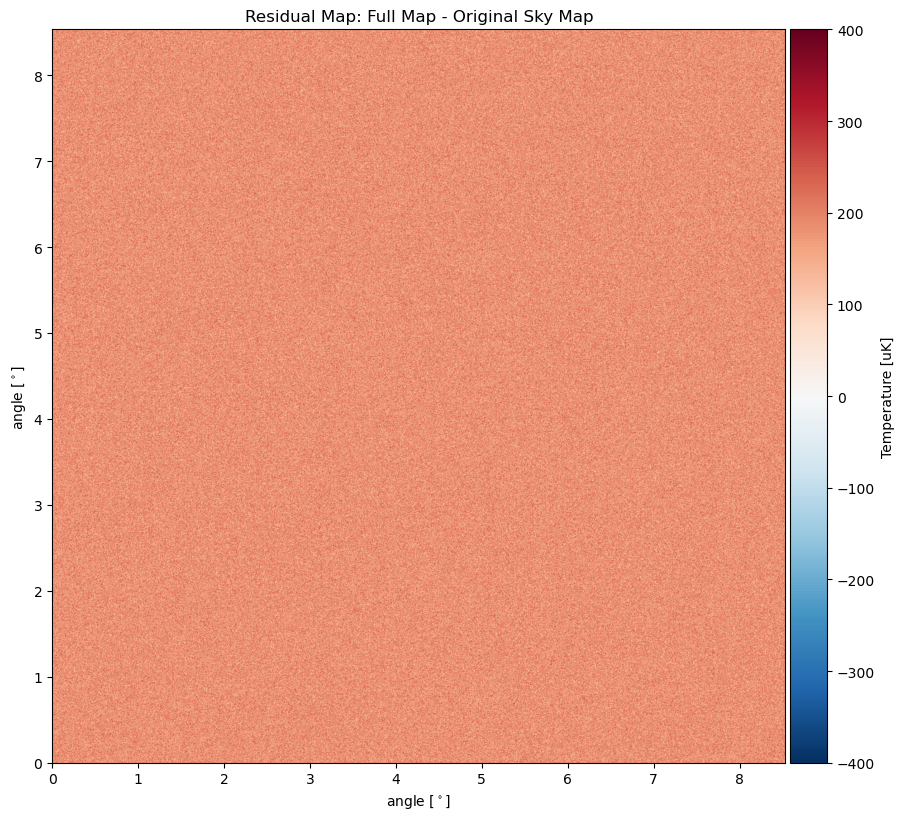

In [270]:
plt.title("Residual Map: Full Map - Original Sky Map")      
p=cmb_modules.Plot_CMB_Map(map_full - sky,c_min,c_max,X_width,Y_width)

Iniciando Scipy CG para 1000 iteraciones...
........
Terminado. Info: 0
map mean: -1.7763568394002505e-15 map rms: 101.5202103345538


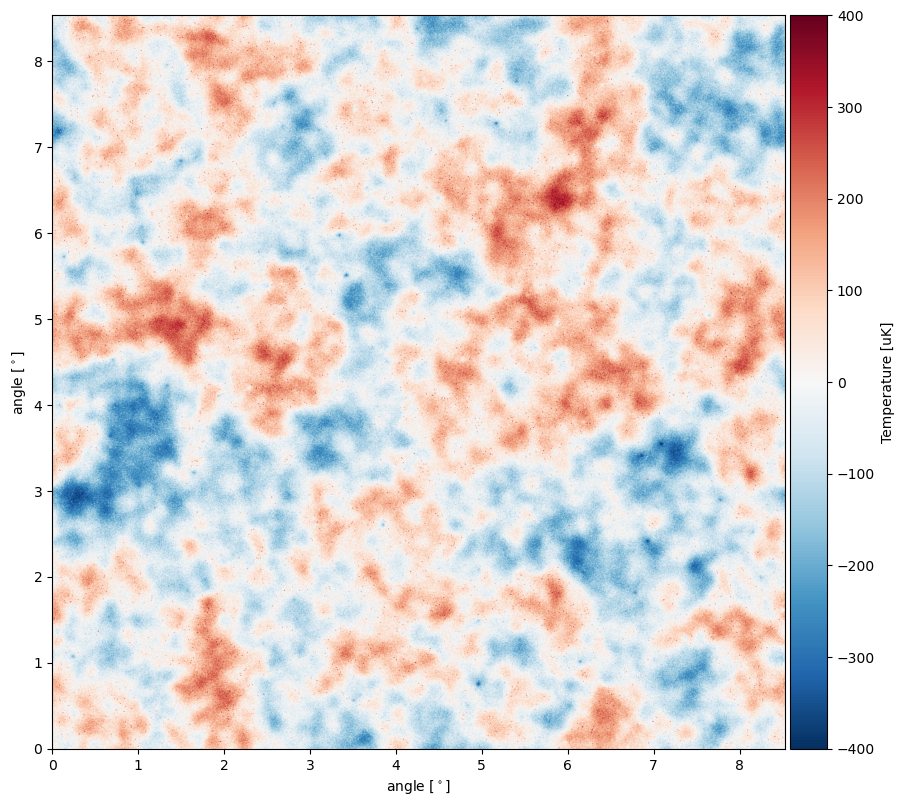

map mean: 66.22635496818532 map rms: 28.32324899963637


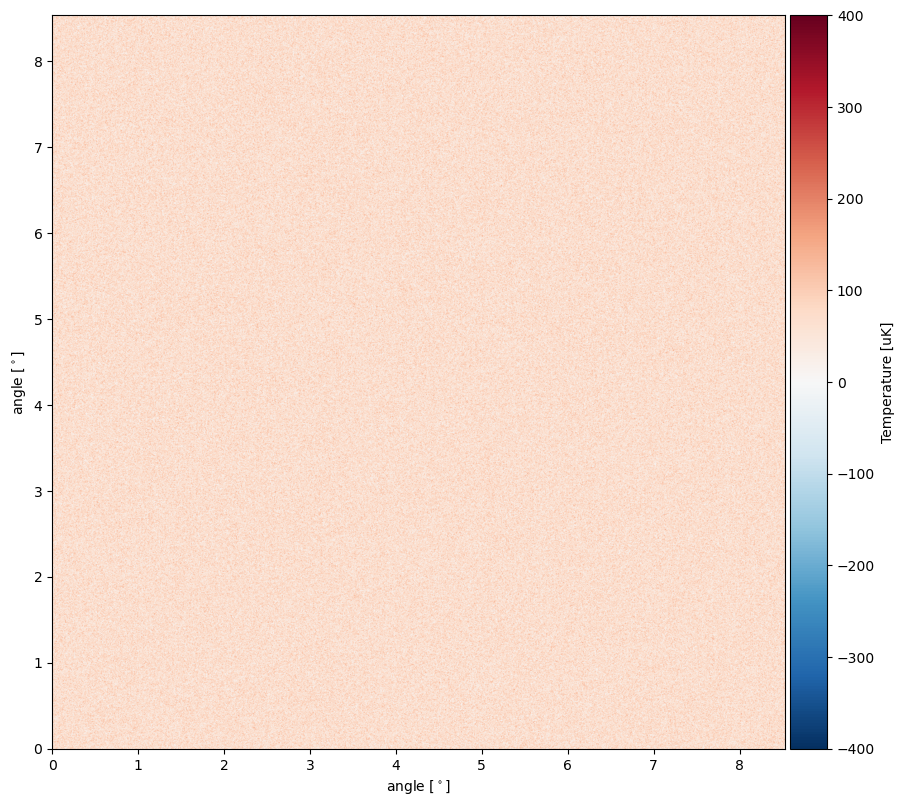

In [ ]:
def solve_full_scipy(dataset, shape, niter=100, verbose=True):
    """
    Solve using Scipy's Conjugate Gradient.
    """
    # 1. Calculamos el tamaño total del vector (N_pixels)
    n_pix = shape[0] * shape[1]

    # 2. Definimos la función Ax = b (igual que antes)
    def matvec_A(x):
        x   = x.reshape(shape) # Scipy trabaja en 1D, inflamos a 2D
        res = np.zeros(shape)
        for data in dataset:
            # P * x (Observar)
            tod  = Observe_map(x, data.point)
            # N^-1 * d (Filtrar ruido)
            tod  = mul_inv_noise(tod, data.noise_spec)
            # P^T * d (Proyectar)
            res += PT(tod, data.point, shape)
        return res.reshape(-1) # Devolvemos 1D

    # 3. 🌟 PASO CLAVE: Crear el LinearOperator 🌟
    # Esto le dice a Scipy: "A es una matriz de tamaño (n_pix, n_pix) 
    # y para multiplicarla usa la función 'matvec_A'"
    A_operator = sp.sparse.linalg.LinearOperator((n_pix, n_pix), matvec=matvec_A, dtype=float)

    # 4. Construir el lado derecho 'b' (igual que antes)
    b = np.zeros(shape)
    for data in dataset:
        tod = mul_inv_noise(data.tod, data.noise_spec)
        b  += PT(tod, data.point, shape)
    b_flat = b.reshape(-1)

    # 5. Resolver usando Scipy
    # callback: función opcional para imprimir el progreso
    def callback_func(xk):
        if verbose:
            # Calcular residuo es costoso, así que solo imprimimos un punto
            print(".", end="", flush=True)

    print(f"Iniciando Scipy CG para {niter} iteraciones...")
    
    # x_sol es la solución, info es 0 si convergió
    x_sol, info = sp.sparse.linalg.cg(A_operator, b_flat, maxiter=niter, callback=callback_func)
    
    if verbose: print(f"\nTerminado. Info: {info}")

    # 6. Devolver con la forma original
    return x_sol.reshape(shape)

map_cg_scipy = solve_full_scipy(dataset, sky.shape, niter=1000)

plt.title("Full MapMaking with Scipy CG taking noise correlations into account")
p=cmb_modules.Plot_CMB_Map(map_cg_scipy - np.mean(map_cg_scipy),c_min,c_max,X_width,Y_width)

plt.title("Residual Map: Scipy CG Full Map - Original Sky Map")
p=cmb_modules.Plot_CMB_Map(map_cg_scipy-sky,c_min,c_max,X_width,Y_width)  #for comparison

### maps with out cross linking

Solving for map while taking noise correlations into account
iteration:    1 conjugate gradient error:   4.6992704e-03
iteration:    2 conjugate gradient error:   8.3642520e-05
iteration:    3 conjugate gradient error:   3.2822165e-06
iteration:    4 conjugate gradient error:   2.7203590e-06
iteration:    5 conjugate gradient error:   1.8432677e-06
iteration:    6 conjugate gradient error:   1.2716435e-06
iteration:    7 conjugate gradient error:   7.0391975e-07
iteration:    8 conjugate gradient error:   5.9296044e-07
iteration:    9 conjugate gradient error:   5.2587767e-07
iteration:   10 conjugate gradient error:   4.0048419e-07
iteration:   11 conjugate gradient error:   3.9299178e-07
iteration:   12 conjugate gradient error:   3.1735159e-07
iteration:   13 conjugate gradient error:   2.9048592e-07
iteration:   14 conjugate gradient error:   2.5909320e-07
iteration:   15 conjugate gradient error:   2.2264840e-07
iteration:   16 conjugate gradient error:   2.0252072e-07
iteration: 

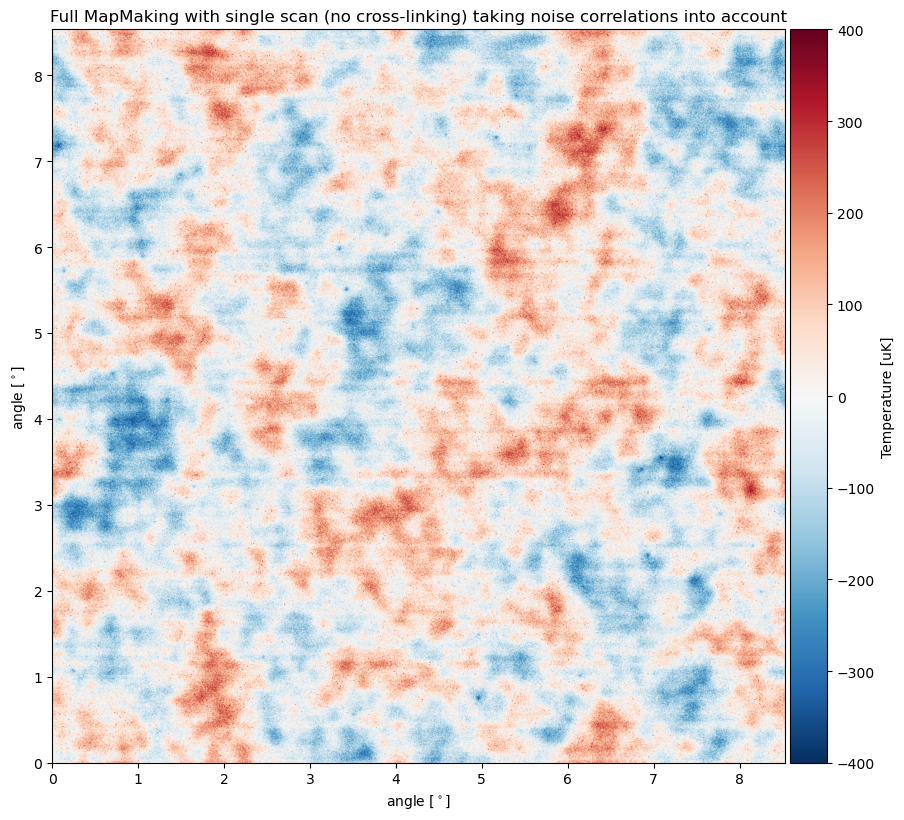

map mean: 66.23805914525245 map rms: 55.36783989583237


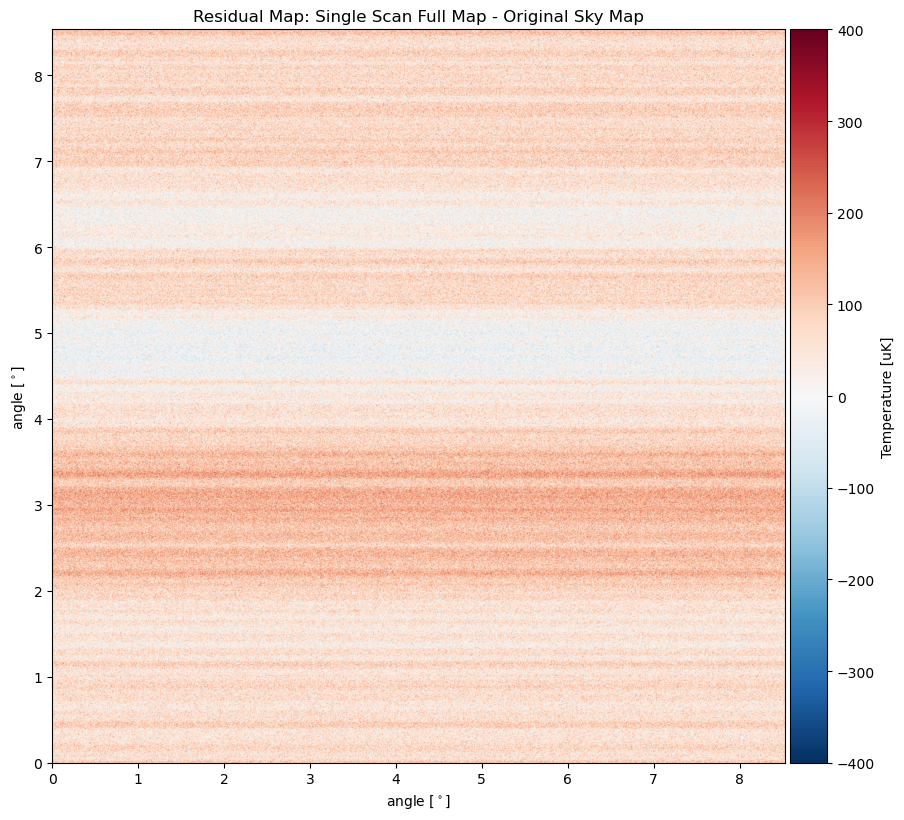

In [272]:
print("Solving for map while taking noise correlations into account")

# aquí hacemos mapmaking sin cross linking (es decir, solo con un escaneo)
map_single = solve_full(dataset[0:1], sky.shape,niter=50)

plt.title("Full MapMaking with single scan (no cross-linking) taking noise correlations into account")
p=cmb_modules.Plot_CMB_Map(map_single - np.mean(map_single),c_min,c_max,X_width,Y_width)

plt.title("Residual Map: Single Scan Full Map - Original Sky Map")
p=cmb_modules.Plot_CMB_Map(map_single-sky,c_min,c_max,X_width,Y_width)  #for comparison 


<font color='red'>EXERCISE: </font>  Compare the cross-linked and non-crosslinked maps.  The horizontal strips in the non-crosslinked maps are refered to (uncreatively) as stripes.

<font color='red'>EXERCISE: </font>  Make plots of these maps in 2-d fourier space

map mean: 43201.14041890511 map rms: 92650.86602349617


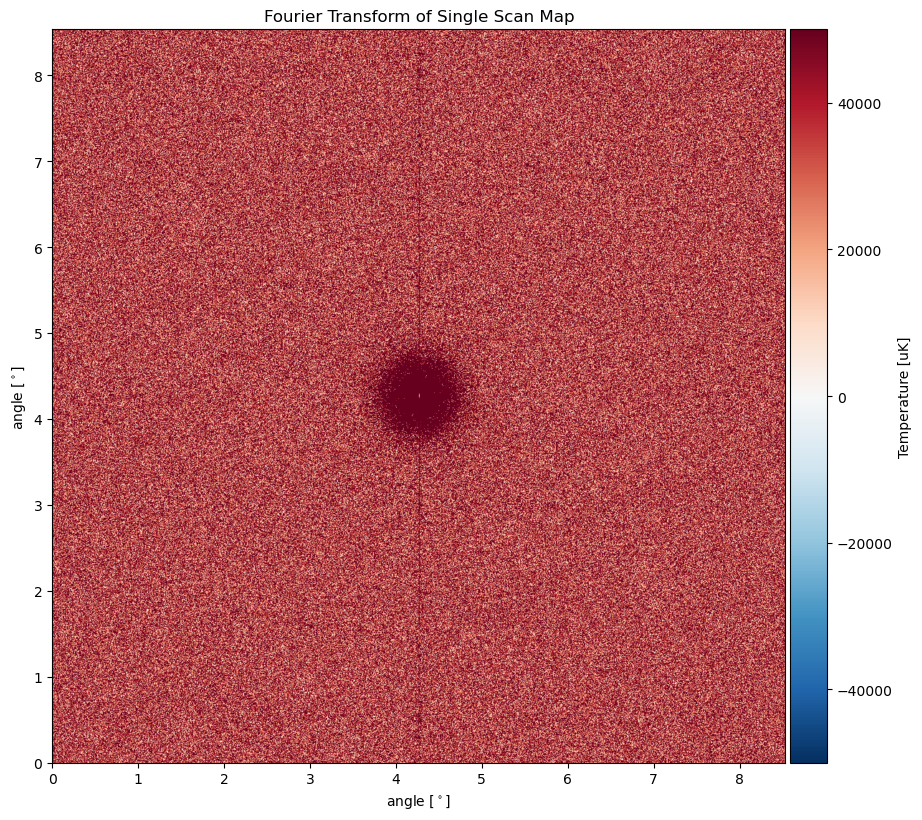

map mean: 33863.27965878135 map rms: 154350.8023811125


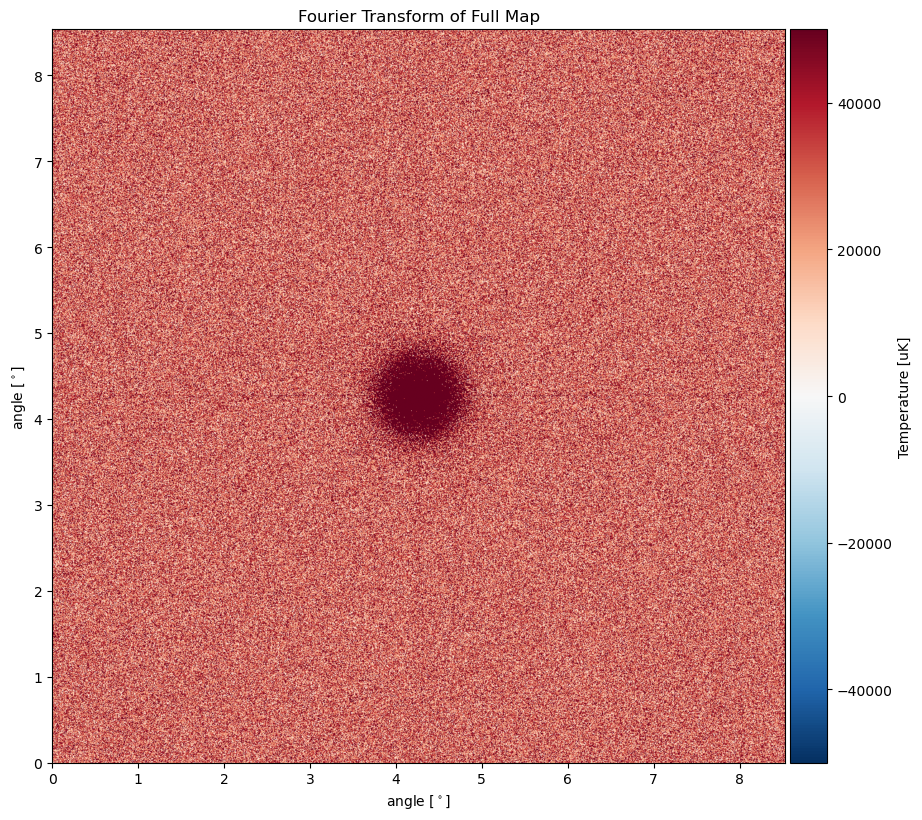

In [273]:
## your code goes here

plt.title("Fourier Transform of Single Scan Map")
p=cmb_modules.Plot_CMB_Map((np.abs(np.fft.ifftshift(np.fft.fft2(map_single))) ) ,-50000,50000  ,X_width,Y_width)

plt.title("Fourier Transform of Full Map")
p=cmb_modules.Plot_CMB_Map((np.abs(np.fft.ifftshift(np.fft.fft2(map_full))) ) ,-50000,50000,X_width,Y_width)

 Compare these 2d fourier plots here. Be sure to note where modes are missing or de-weighted in each map. 

<font color='red'>EXERCISE: </font>  Filter the non-crosslinked map to remove the stripes.  The can be accomplised by masking the relevent modes in your 2d fourier plot before inverse fouerier transforming to create the map.

map mean: 0.05208004559241491 map rms: 98.86456598920664


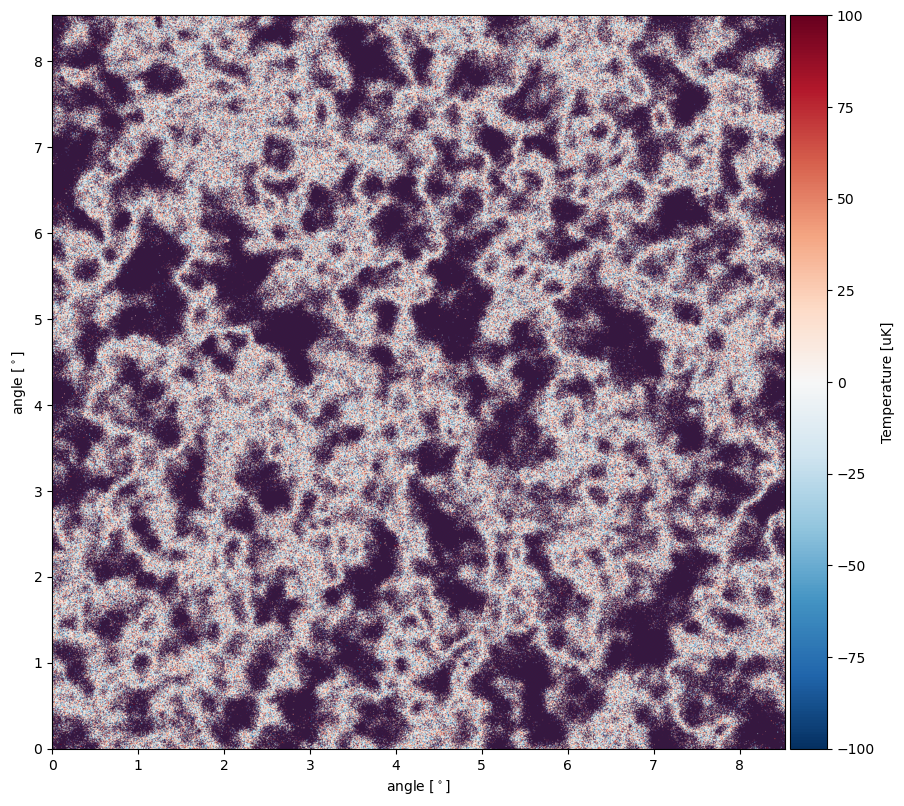

In [224]:
## your code goes here

filter = cmb_modules.Filter_Map(map_single,N, 1)

filter[0]

cmb_modules.Plot_CMB_Map(filter,c_min/4.,c_max/4.,X_width,Y_width)



comment on the difference between the filter map non-crosslinked map, the crosslinked map, and the input map.   Make difference plots if that seems useful.

Mapa Filtrado (Sin Rayas):
map mean: -4.683753385137379e-17 map rms: 55.13075763094783


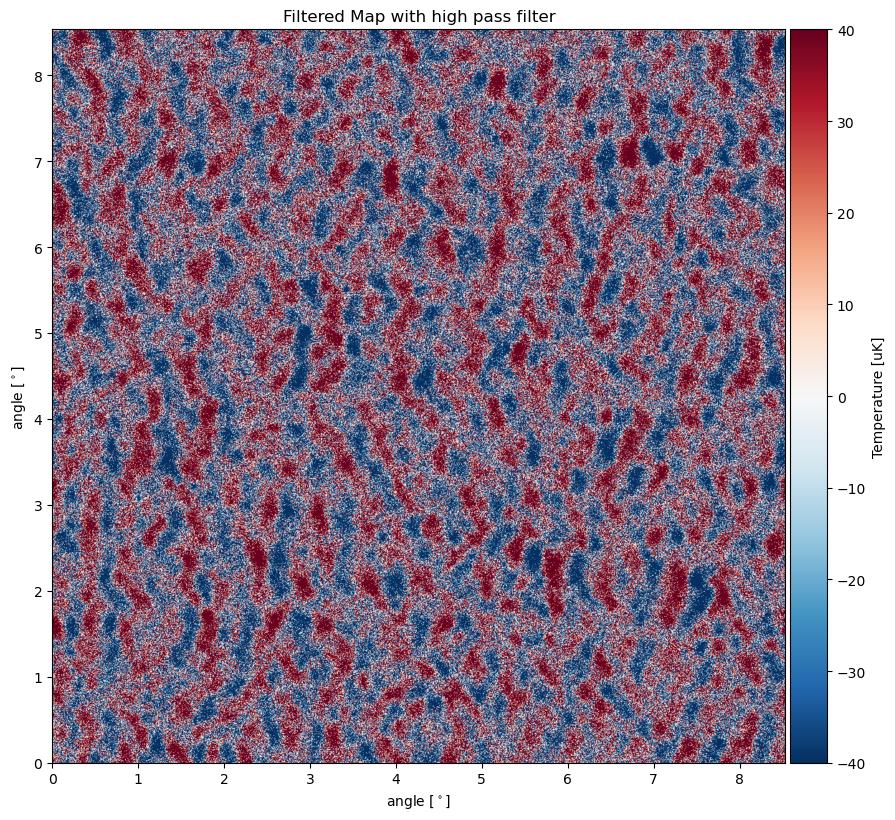

map mean: 66.22633665962394 map rms: 97.59731663367603


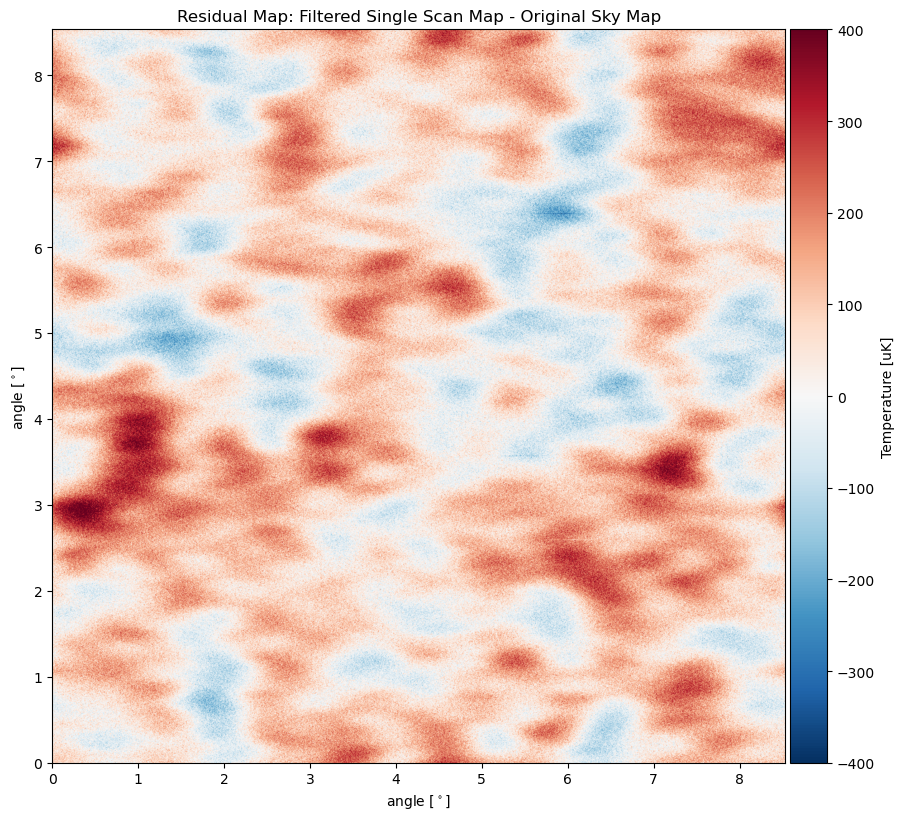

In [275]:
def Filter_Map(Map, N, N_mask):
    # 1. Generar coordenadas (igual que tenías)
    ones = np.ones(N)
    inds = (np.arange(N) + .5 - N/2.)
    X = np.outer(ones, inds)  # Coordenada Horizontal (kx)
    
    # 2. Crear la máscara (Mata la franja vertical central en Fourier)
    # Esto elimina las frecuencias bajas en X (rayas horizontales)
    mask = np.ones([N, N])
    mask[np.where(np.abs(X) < N_mask)] = 0
    
    # 3. Aplicar filtro (Orden Estándar)
    # Real -> Fourier
    FMap = np.fft.fftshift(np.fft.fft2(Map)) 
    
    # Aplicar Máscara
    FMap_filtered = FMap * mask
    
    # Fourier -> Real
    # Usamos ifft2 para volver, y tomamos la parte real
    Map_filtered = np.real(np.fft.ifft2(np.fft.ifftshift(FMap_filtered)))
    
    return Map_filtered, mask

# --- USANDO LA FUNCIÓN ---

# 1. Definimos un ancho de máscara (prueba con 10 o 20 píxeles para borrar bien el ruido)
N_mask_val = 10

# 2. Desempaquetamos correctamente (mapa y máscara por separado)
mapa_limpio, mascara_usada = Filter_Map(map_single, N, N_mask_val)

# 3. Graficamos
# Nota: Al quitar el ruido, el rango de la señal baja mucho. 
# Ajustamos la escala (divide por 10 o ajusta según lo que veas)
print("Mapa Filtrado (Sin Rayas):")
plt.title("Filtered Map with high pass filter")  
cmb_modules.Plot_CMB_Map(mapa_limpio, c_min/10., c_max/10., X_width, Y_width)

plt.title("Residual Map: Filtered Single Scan Map - Original Sky Map")
p=cmb_modules.Plot_CMB_Map(mapa_limpio - sky, c_min, c_max, X_width, Y_width)

# Opcional: Ver la máscara para entender qué borramos
# plt.imshow(mascara_usada)